#Modelo de población. Ecuación logística.

Vamos a partir de un sistema gobernado por la ecuación:

$$\frac{\partial N}{\partial t}(x,t) = \alpha N \left( 1 - \frac{1}{C(x,t)}N \right) + \nu \nabla^2 N.$$

Esta ecuación es una versión de la ecuación logística. Podemos interpretarlo como un modelo de población tanto en el espacio como en el tiempo donde $N(x,t)$ es la población que se encuentra en cierta posición en un determinado tiempo, $C(x,t)$ representa el valor de saturación de la población dado los recursos que se encuentran, $\alpha$ es la tasa de creciciento de la población cuando existen infinitos recursos y $\nu$ un parámetro que determina la migración de individuos hacia áreas menos pobladas.

Utilizaremos para este modelo recursos que oscilarán en el espacio y el tiempo, representando el cambio en las estaciones de las zonas más aptas para vivir. Entonces, tendrá la forma funcional:

$$ C(x,t) = c_0 (1 + 0.8 \cos(\omega_1 t) \sin (\omega_2 x)).$$

$\bf a)$ Escriba un método pseudoespectral (con Runge-Kutta de orden 2 midpoint para el tiempo) que integre el sistema presentado anteriormente usando $N = 1024$ puntos de grilla, $dt = 1 \times 10^{-3}$, $\nu = 5 \times 10^{-5}$, $\alpha = 0.2$, $c_0 = 15$, $t_f = 4 \pi$, $\omega_1 = 2$, $\omega_2 = 1$ y $x \in [0, 2\pi]$. Use como condición inicial una población constante de 10 en todos lados. Grafique como una imagen $N(x,t)$.

$\bf b)$ Aplique la técnica de descomposición ortogonal empírica para separar la solución en componentes temporales y espaciales. Grafique ordenadamente los autovalores e interprete su significado. Grafique para distinto número de modos (1, 2, 3, etc) y relacionelo con los autovalores. ¿Qué criterio puede utilizar para elegir el número de modos?

$\bf c)$ Plantee analíticamente una descomposición de Galerkin en funciones genéricas para esta ecuación. (se recomienda hacerlo con detenimiento)

$\bf e)$ Ahora realice el proceso inverso. Usando el item $\bf b$, escriba un código que tome los primeros $n$ modos que obtiene de POD y escriba un integrador que evolucione estos modos. Use las mismas condiciones que en el item $a$. Para la condición inicial proyecte la utilizada en los modos elegidos. Pruebe para tres $n$ distintos y que uno sea 3.¿Qué conclusiones obtiene?

$\bf f)$ Para $n=3$ varíe el parámetro $\alpha$ y use el integrador obtenido del punto anterior. En este caso no estaremos usando los modos de POD que sabemos que forman parte de la solución. Compare con la integración directa de este caso. ¿Por qué los modos POD de un problema con otros parámetros sigue funcionando en este caso?

$\bf g)$ Repita el punto anterior pero ahora con $\omega_1 = 1$.


$\bf h)$ Escriba un integrador temporal para de 3 modos Fourier para esta ecuación (se recomienda reciclar el anterior). Compare con los resultados de POD que obtuvo en el item $\bf e$.

(opcional: encuentre un régimen nuevo de parámetros para los cuales los 3 modos obtenidos de POD no permiten reflejar la dinámica)

[IMPORTANTE: RESOLVER LOS ITEMS EN CELDAS SEPARADAS, MARCANDO CLARAMENTE QUÉ ITEM SE ESTA RESOLVIENDO]


In [ ]:
#@title Librerias
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter
from IPython.display import Image

In [1]:
#@title Funcion Animacion
def animacion(size,matriz,titulo,ejex,ejey,x,dt,tf,duracion):
  step = int(tf/dt)
  Afig, Aax = plt.subplots(figsize=size)
  line, = Aax.plot(x,matriz[0])

  title = Aax.set_title(titulo+', $t=0$')
  Aax.set_xlabel(ejex)
  Aax.set_ylabel(ejey)
  Aax.set_ylim(np.min(matriz),np.max(matriz))
  Aax.set_xlim(np.min(x),np.max(x))

  Frames = np.linspace(0,step-1,duracion*30,dtype=int)

  def update(i):
    frame = Frames[i]
    line.set_ydata(matriz[frame])
    title.set_text(titulo+f', $t={round(frame*dt,3)}$')
    return line, title,

  ani = FuncAnimation(Afig, update, frames=len(Frames), blit=True, repeat=False)

  gif_path = 'titulo.gif'
  ani.save(gif_path,writer=PillowWriter(fps=30))
  plt.close(Afig)
  display(Image(filename=gif_path))

In [ ]:
#@title $\bf a)$ Evolucion con el metodo pseudoespectral, utilizando un RK2
def evol(u,C,k,nu,alpha,nx,dt):
    f = np.fft.rfft(u)
    ft = f
    for ord in [2,1]:
        D = dt/ord
        fnl = compute_NL(f,C,k,nx)
        f = ft - D * (alpha*fnl + (nu*k**2 - alpha) * f)
        f[int(nx/3):] = 0
    return np.fft.irfft(f)

def compute_NL(f,C,k,nx):
    v = np.fft.irfft(f)
    v = v*v/C
    return np.fft.rfft(v)

In [ ]:
#@title Evolucionando para los parametros marcados en la consigna
step = int(4000 *np.pi)
#
nt = step
dt = 1e-3
nx = 1024
dx = 2*np.pi / (nx-1)

nu = 5e-5
alpha = 0.2
c0 = 15
omega1 = 2
omega2 = 1
w1 = 2
w2 = 1


x = np.linspace(0,2*np.pi,nx,endpoint=False)
t = np.arange(step) * dt
k = np.arange(0,nx/2+1)

tf = t[-1]

X,T = np.meshgrid(x,t)


def C(x,t,c0,w1,w2):
  return c0*(1+.8*np.cos(w1*t)*np.sin(w2*x))

Cmatriz = np.zeros((step,nx))

for i in range(0,step):
  Cmatriz[i] = C(x,t[i],c0,w1,w2)

C = c0 * (1 + 0.8*np.cos(omega1*T)*np.sin(omega2*X))
C = C.T

out = np.zeros((nx,step))
out[:, 0] = 10 * np.ones(nx)

for i in np.arange(step-1):
    out[:,i+1] = evol(out[:,i],Cmatriz.T[:,i],k,nu,alpha,nx,dt)

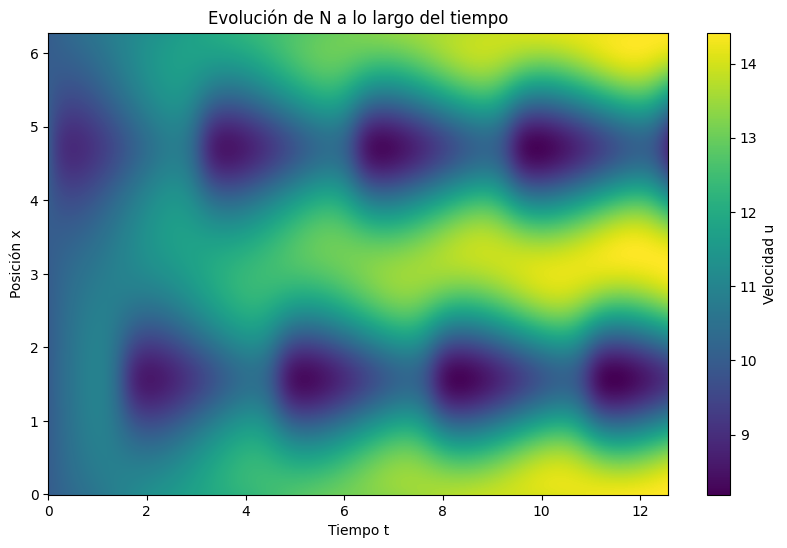

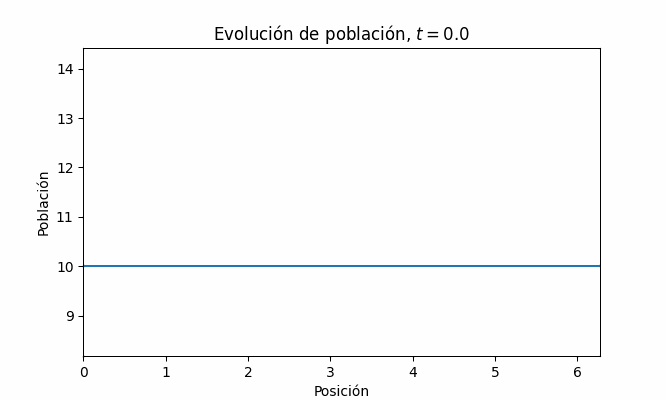

In [ ]:
#@title .
plt.figure(figsize=(10, 6))
plt.pcolormesh(T, X, out.T, cmap='viridis')
plt.colorbar(label='Velocidad u')
plt.title('Evolución de N a lo largo del tiempo')
plt.ylabel('Posición x')
plt.xlabel('Tiempo t')
plt.show()

animacion((20/3,4),out.T,'Evolución de población','Posición','Población',x,dt,tf,6)

In [ ]:
#@title $\bf b)$ Diago y armado de S, a partir de la funcion np.linalg.svd
U, s, V = np.linalg.svd(out, full_matrices=True)
Vt = V

S = np.zeros((nx,step), dtype=complex)
S[:len(s), :len(s)] = np.diag(s)

U3 = U[:, :3]
S3 = S[:3, :3]
V3 = V[:3, :]

out_3 = np.dot(U3, np.dot(S3, V3))
out_3 = out_3.real

In [ ]:
#@title Funcion para la reconstruccion de modos y para un solo modo

def reconstruir_con_modos(U,s,Vt, n_modos):

    U_reducido = U[:, :n_modos]
    s_reducido = s[:n_modos]
    Vt_reducido = Vt[:n_modos, :]

    Sigma_reducido = np.diag(s_reducido)

    matriz_reconstruida = np.dot(U_reducido, np.dot(Sigma_reducido, Vt_reducido))

    return matriz_reconstruida , U_reducido, Sigma_reducido, Vt_reducido

def reconstruir_con_un_modo(U, s, Vt, modo):

    U_modo = U[:, modo-1:modo]
    s_modo = s[modo-1:modo]
    Vt_modo = Vt[modo-1:modo, :]

    Sigma_modo = np.diag(s_modo)

    matriz_reconstruida = np.dot(U_modo, np.dot(Sigma_modo, Vt_modo))

    return matriz_reconstruida, U_modo, Sigma_modo, Vt_modo


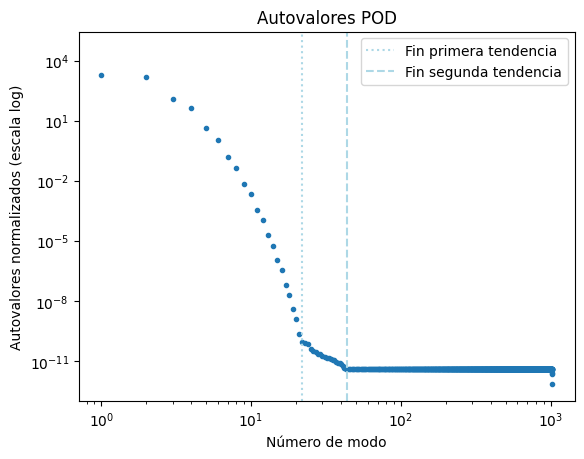

In [ ]:
#@title Autovalores

plt.semilogy(s,'.')
plt.yscale('log')
plt.xscale('log')
plt.axvline(x=22,c='lightblue',linestyle=':',label='Fin primera tendencia')
plt.axvline(x=44,c='lightblue',linestyle='--',label='Fin segunda tendencia')
plt.xlabel('Número de modo')
plt.ylabel('Autovalores normalizados (escala log)')
plt.title('Autovalores POD')
plt.legend()

Para seleccionar modos se nos ocurren dos criterios. El primero se basa en notar que los puntos toman tres tendencias distintas, siendo la tercer tendencia donde el valor es practicamente constante y a partir de la cual podriamos descartar modos para solo quedarnos con los que mas aportan. El segundo sería ver cuando conseguimos el 99% del aporte total, y descartar el resto. El primero es mas cualitativo y sencillo de aplicar, mientras que el segundo nos asegura una manera eficiente de obtener un buen nivel de reconstrucción de los aportes, pero es menos directo. Veamos que nos da cada uno.

In [ ]:
#@title Elección cualitativa
#La tercer tendencia comienza en el modo 44
modos_cual=44
for i in range(modos_cual+1):
  aporte_total_1=sum(norma_s[:i] )
#Elección cuantitativa
s_truncada=[]
for i in range(len(norma_s)):
  aporte_total_2=sum(norma_s[:i] )
  s_truncada.append(norma_s[i] )
  if aporte_total_2>0.99:
    break

print('Elección cualitativa')
print('Cantidad de modos',modos_cual)
print('Fracción reconstruida:',aporte_total_1)

print('Elección cuantitativa')
print('Cantidad de modos',len(s_truncada))
print('Fracción reconstruida:',aporte_total_2)

4
Elección cualitativa
Cantidad de modos 44
Fracción reconstruida: 0.9999999999999094
Elección cuantitativa
Cantidad de modos 4
Fracción reconstruida: 0.9962188318404303


Concluímos que el enfoque cuantitativo es mejor, ya que logra una reconstrucción comparable al otro método con un décimo de los modos.


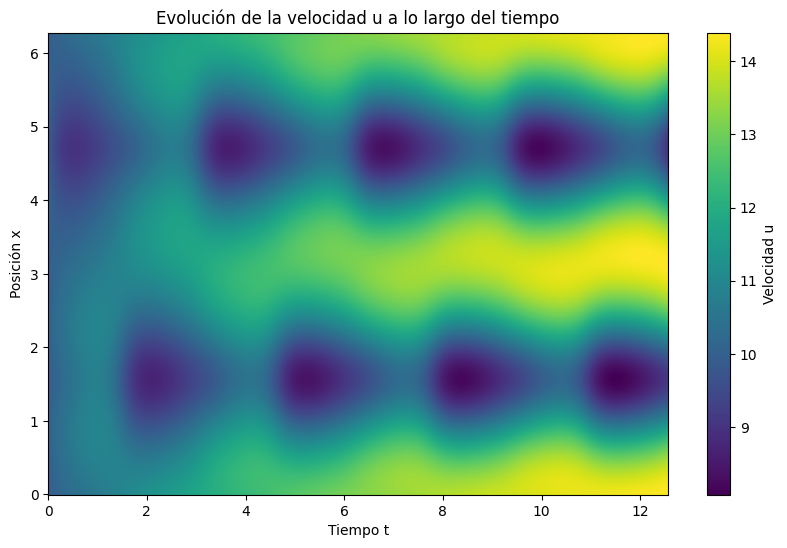

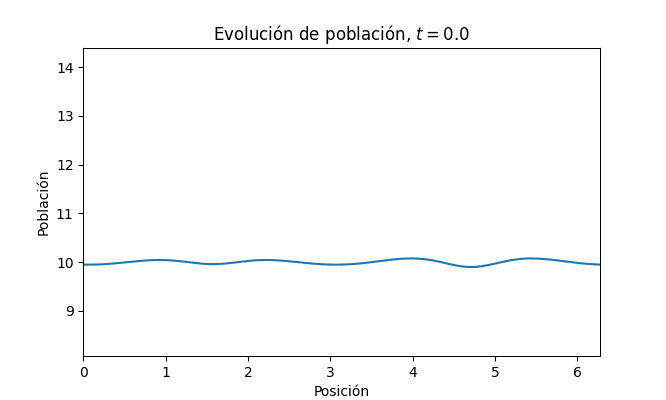

In [ ]:
#@title Reconstruccion para $3$ modos
out_3 = reconstruir_con_modos(U,s,Vt,3)[0]

plt.figure(figsize=(10, 6))
plt.pcolormesh(T, X, out_3.T, cmap='viridis')
plt.colorbar(label='Velocidad u')
plt.title('Evolución de la velocidad u a lo largo del tiempo')
plt.ylabel('Posición x')
plt.xlabel('Tiempo t')
plt.show()

animacion((20/3,4),out_3.T,'Evolución de población','Posición','Población',x,dt,tf,6)

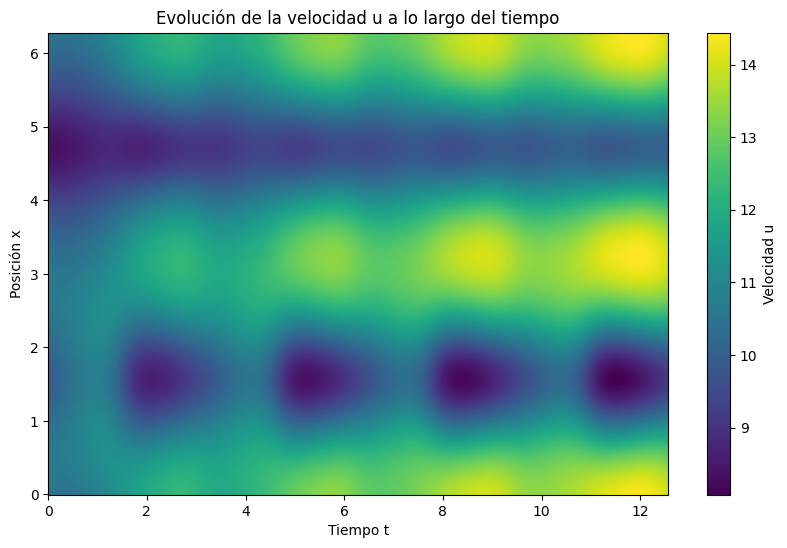

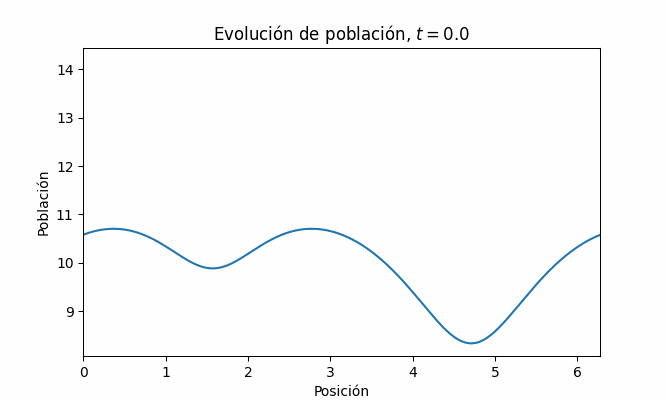

In [ ]:
#@title Reconstruccion para $2$ modos
out_2 = reconstruir_con_modos(U,s,Vt,2)[0]

plt.figure(figsize=(10, 6))
plt.pcolormesh(T, X, out_2.T, cmap='viridis')
plt.colorbar(label='Velocidad u')
plt.title('Evolución de la velocidad u a lo largo del tiempo')
plt.ylabel('Posición x')
plt.xlabel('Tiempo t')
plt.show()

animacion((20/3,4),out_2.T,'Evolución de población','Posición','Población',x,dt,tf,6)

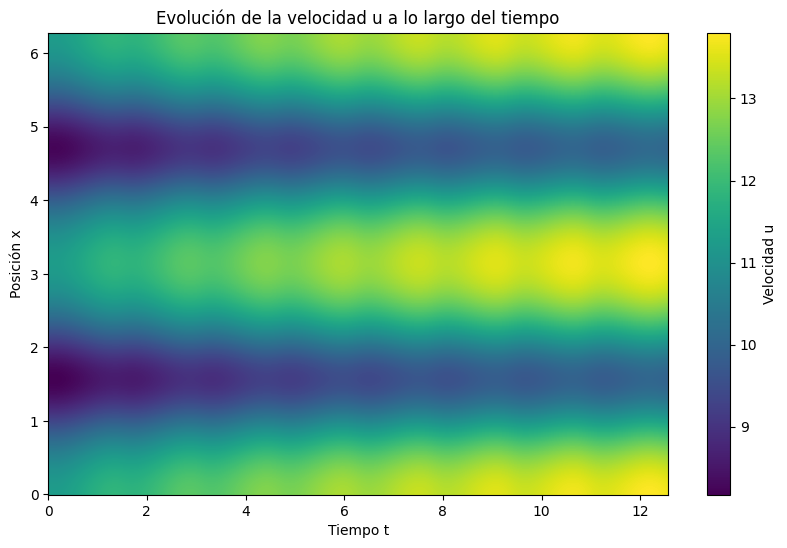

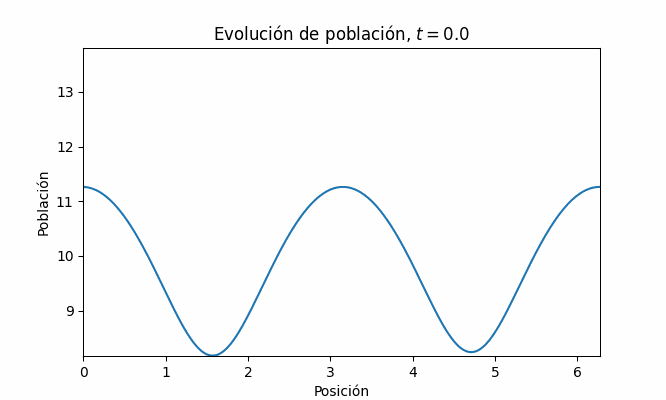

In [ ]:
#@title Reconstruccion para $1$ modo
out_1 = reconstruir_con_modos(U,s,Vt,1)[0]

plt.figure(figsize=(10, 6))
plt.pcolormesh(T, X, out_1.T, cmap='viridis')
plt.colorbar(label='Velocidad u')
plt.title('Evolución de la velocidad u a lo largo del tiempo')
plt.ylabel('Posición x')
plt.xlabel('Tiempo t')
plt.show()

animacion((20/3,4),out_1.T,'Evolución de población','Posición','Población',x,dt,tf,6)

In [ ]:
#@title Reconstrucción de unicamente los modos $2$ y $3$ a partir de SVD
out_2 = reconstruir_con_un_modo(U, s, Vt, 2)[0]

plt.figure(figsize=(10, 6))
plt.pcolormesh(T, X, out_2.T, cmap='viridis')
plt.colorbar(label='Velocidad u')
plt.title('Evolución de la velocidad u con el modo 2')
plt.ylabel('Posición x')
plt.xlabel('Tiempo t')
plt.show()

animacion((20/3,4), out_2.T, 'Evolución de población (Modo 2)', 'Posición', 'Población', x, dt, tf, 6)

out_3 = reconstruir_con_un_modo(U, s, Vt, 3)[0]

plt.figure(figsize=(10, 6))
plt.pcolormesh(T, X, out_3.T, cmap='viridis')
plt.colorbar(label='Velocidad u')
plt.title('Evolución de la velocidad u con el modo 3')
plt.ylabel('Posición x')
plt.xlabel('Tiempo t')
plt.show()

animacion((20/3,4), out_3.T, 'Evolución de población (Modo 3)', 'Posición', 'Población', x, dt, tf, 6)


Output hidden; open in https://colab.research.google.com to view.

$\bf c)$ Recordando que $\frac{\partial N}{\partial t}(x,t) = \alpha N \left( 1 - \frac{1}{C(x,t)}N \right) + \nu \nabla^2 N.$ y tomando solucion de la forma $ \displaystyle N = \sum_{j=1}^{n} a_j(t) \, \varphi_j(x)$, donde $ \displaystyle \int_{0}^{2\pi} \varphi_i \, \varphi_j \, \omega \, dx = \delta_{ij}$, osea funciones ortonormales.
Podemos decir que tenemos un problema del estilo $\partial_t N = F(N)$. podemos hacer el remplazo teniendo encuenta como aplican los operadores aplican en 1D:

$$ \partial_t N = \sum_{j=1}^{n} \dot{a_j}(t) \, \varphi_j(x) $$

$$ \partial_{xx} N = \sum_{j=1}^{n} a_j(t) \, \varphi_j''(x) $$

$$ N^2/C = (\sum_{j=1}^{n} a_j(t) \, \varphi_j(x) ) ( \sum_{k=1}^{n} a_k(t) \, \varphi_k(x))/C = \frac{\sum_{j,k}^{n} a_j(t) a_k(t) \, \varphi_j(x) \varphi_k(x)}{C} $$

entonces reemplazando:

$$ \sum_{j=1}^{n} \dot{a_j}(t) \, \varphi_j(x) = \alpha N = \sum_{j=1}^{n} a_j(t) \, \varphi_j(x) -  \alpha \frac{\sum_{j,k}^{n} a_j(t) a_k(t) \, \varphi_j(x) \varphi_k(x)}{C} + \nu \sum_{j=1}^{n} a_j(t) \, \varphi_j''(x) $$

Aplicando ortogonalidad, osea integrando ambos miembros por $\int \varphi_i \omega \, dx$

$$ \sum_{j=1}^{n} \dot{a_j} \, \int \varphi_i \varphi_j \omega \, dx = \sum_{j=1}^{n} a_j \,  \int \varphi_i \varphi_j \omega \, dx -  \alpha \sum_{j,k}^{n} a_j a_k \,  \int \frac{\varphi_i \varphi_j  \, \varphi_k}{C} \omega \, dx + \nu \sum_{j=1}^{n} a_j \, \int \varphi_i \varphi_j'' \omega \, dx $$


\begin{equation}
\dot{a_k} = \alpha \, a_k + \sum_{i=1}^{n} \nu \, a_i \int \varphi_i'' \, \varphi_k \, \omega \, dx - \alpha \sum_{i, \, j}^{n} a_i \, a_j \int \frac{\varphi_i \, \varphi_j \, \varphi_k}{C} \omega \, dx
\end{equation}

Discretizndo los datos podemos ver que la cantidad de ecuacion diferenciales a resolver sera igual a la cantidad de modos que vamos a utilizar. Tomemos como ejemplo un recorte a 3 modos. donde $\varphi_j$ es el j-esimo modo espacial del SVD.

In [ ]:
#@title $\bf e)$ reconstruccion para los $3$ primeros modos de SVD, por lo que $n=3$

n = 3
n_modos = n

U_n = reconstruir_con_modos(U,s,V,n)[1]
S_n = reconstruir_con_modos(U,s,V,n)[2]
Vt_n = reconstruir_con_modos(U,s,V,n)[3]

In [ ]:
#@title Integrador RK2

from tqdm import tqdm #nanomagia

def integrador_rk(a_j, dt, alpha, nu, C, phi, dx):

    f = a_j

    for ord in [2, 1]:
        D = dt / ord

        # 1. Término no lineal:
        integral_phi = np.zeros_like(a_j)
        for j in range(len(a_j)):
            for k in range(len(a_j)):
                for l in range(len(a_j)):
                    # Sumar el término no lineal de Galerkin
                    integral_phi[j] += a_j[k] * a_j[l]  * np.sum( phi[j] * phi[k] * phi[l] / C )

        # 2. Término difusivo
        diffusion_term = np.zeros_like(a_j)
        for j in range(len(a_j)):
            for k in range(len(a_j)):
                # Calcula la segunda derivada espacial (gradiente doble)
                grad_phi_k = np.gradient(phi[k], dx)  # Primer gradiente
                grad2_phi_k = np.gradient(grad_phi_k, dx)  # Segundo gradiente
                diffusion_term[j] += a_j[k] * np.sum( grad2_phi_k * phi[j])

        # 3. Ecuación diferencial proyectada de Galerkin:
        f = a_j + D * (alpha * f - alpha * integral_phi + nu * diffusion_term)

    return f

##Vale la pena resaltar el apoyo en lograr que funcione el algoritmo gracias al compañero martin hermitiano.

In [ ]:
#@title Evolucion

# Inicialización de variables
step = int(4000 * np.pi)
a_j_solucion = np.zeros((step, n_modos))

# Inicializa phi con los primeros modos
phi = np.zeros((n_modos, U_n.shape[0]))
for i in range(n_modos):
    phi[i] = U_n[:, i]

# Función C (depende del espacio y el tiempo)
def C(x, t, c0, w1, w2):
    return c0 * (1 + 0.8 * np.cos(w1 * t) * np.sin(w2 * x))

# Matriz de C
Cmatriz = np.zeros((step, nx))
for i in range(step):
    Cmatriz[i] = C(x, t[i], c0, w1, w2)

# Valor inicial de a_j
a_j_inicial = np.zeros(n_modos)
U_x_0 = 10 * np.ones(nx)

# Proyección para la condicion inicial en la base utilizada
for i in range(n_modos):
    a_j_inicial[i] = np.sum(U_x_0 * phi[i])

for i in tqdm(range(step)):
    a_j_solucion[i] = integrador_rk(a_j_inicial, dt, alpha, nu, Cmatriz[i], phi, dx)
    a_j_inicial = a_j_solucion[i]

100%|██████████| 12566/12566 [00:23<00:00, 524.25it/s]


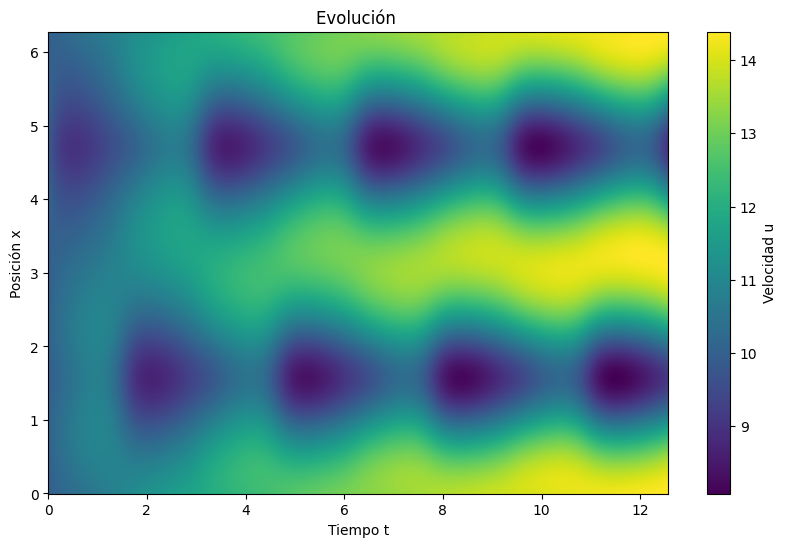

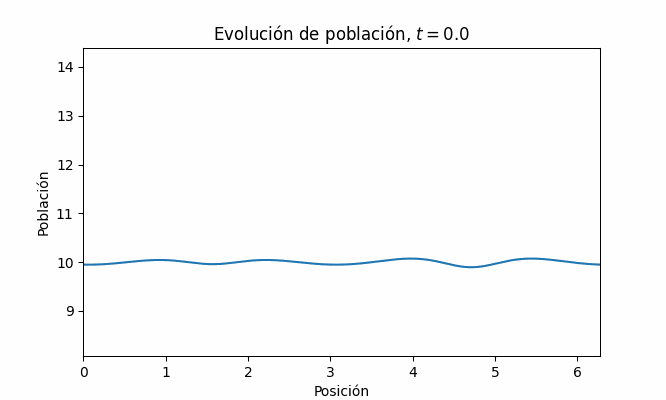

In [ ]:
#@title Construccion y grafico de $N$ a partir de $\sum a_j \varphi_j$
U_prueba = np.zeros((step, nx))  # Matriz para U en todos los pasos de tiempo
tf = t[-1]
tf

# Bucle para calcular U en cada paso de tiempo
for i in range(step):
    for j in range(n_modos):
        U_prueba[i] += a_j_solucion[i, j] * phi[j]  # Suma ponderada de los modos

X,T = np.meshgrid(x,t)

plt.figure(figsize=(10, 6))
plt.pcolormesh(T, X, U_prueba, cmap='viridis')
plt.colorbar(label='Velocidad u')
plt.title('Evolución ')
plt.ylabel('Posición x')
plt.xlabel('Tiempo t')
plt.show()

animacion((20/3,4),U_prueba,'Evolución de población','Posición','Población',x,dt,tf,6)

En una primera impresion la construccion de $N$ a partir de la evolucion de los $a_j$ con los $\varphi_j$ del SVD es identica a la ya vista antes. Veamos como son las diferencias en las siguientes celdas

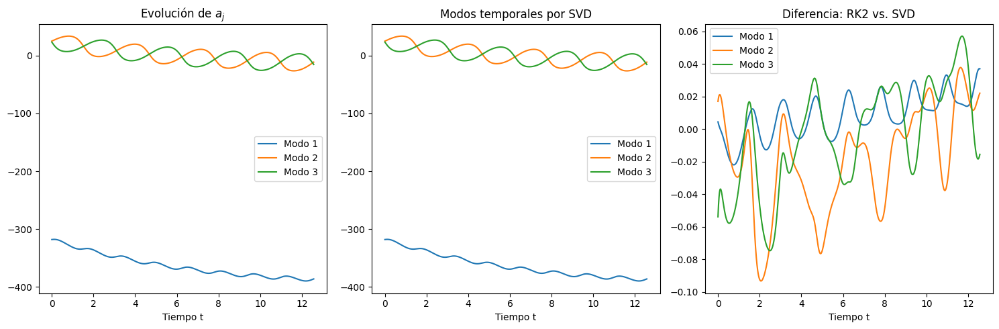

In [ ]:
#@title Diferencias
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Primer gráfico: Evolución de los modos a_j
axes[0].plot(t, a_j_solucion[:, 0], label='Modo 1')
axes[0].plot(t, a_j_solucion[:, 1], label='Modo 2')
axes[0].plot(t, a_j_solucion[:, 2], label='Modo 3')
axes[0].set_title(r'Evolución de $a_j$')
axes[0].set_xlabel('Tiempo t')
axes[0].legend()  # Agregar leyenda

# Segundo gráfico: Modos temporales por SVD
axes[1].plot(t, (np.dot(S3, V3))[0].real, label='Modo 1')
axes[1].plot(t, (np.dot(S3, V3))[1].real, label='Modo 2')
axes[1].plot(t, (np.dot(S3, V3))[2].real, label='Modo 3')
axes[1].set_title('Modos temporales por SVD')
axes[1].set_xlabel('Tiempo t')
axes[1].legend()  # Agregar leyenda

# Tercer gráfico: Diferencia entre RK2 y SVD
axes[2].plot(t, a_j_solucion[:, 0] - (np.dot(S3, V3))[0], label='Modo 1')
axes[2].plot(t, a_j_solucion[:, 1] - (np.dot(S3, V3))[1], label='Modo 2')
axes[2].plot(t, a_j_solucion[:, 2] - (np.dot(S3, V3))[2], label='Modo 3')
axes[2].set_title('Diferencia: RK2 vs. SVD')
axes[2].set_xlabel('Tiempo t')
axes[2].legend()  # Agregar leyenda

# Ajustar el layout para evitar solapamientos
plt.tight_layout()
plt.show()


A partir de los graficos de arriba es claro ver los aportes a la dinamica que realizan cada modo temporal, siendo el modo de mayor aporte el que realiza el aumento medio de la poblacion, mientras que los otros dos da lugar a las oscilacion en $\frac{\pi}{2}$ y $\frac{3\pi}{2}$ aproximadamente.



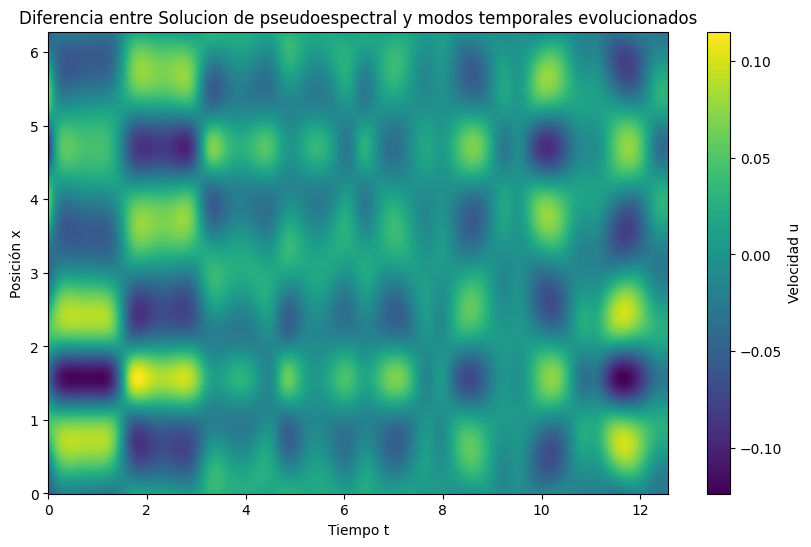

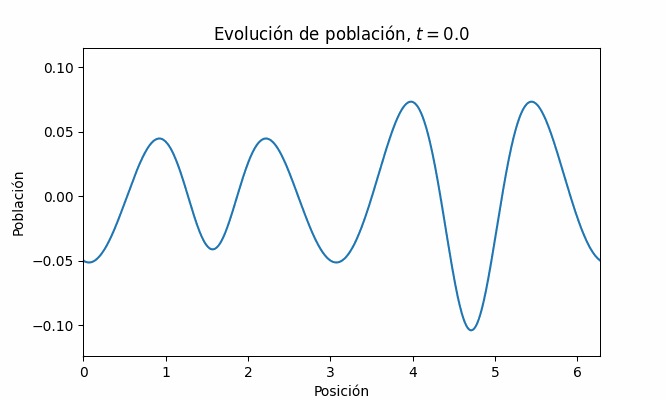

In [ ]:
#@title Diferencia entre $N_{\text{pseudoespectral}}$ y $N$ a partir de la evolucion de los modos temporales $t=8\pi$
U_prueba = np.zeros((step, nx))  # Matriz para U en todos los pasos de tiempo
tf = t[-1]
tf

for i in range(step):
    for j in range(n_modos):
        U_prueba[i] += a_j_solucion[i, j] * phi[j]

X,T = np.meshgrid(x,t)

plt.figure(figsize=(10, 6))
plt.pcolormesh(T, X, U_prueba - out.T, cmap='viridis')
plt.colorbar(label='Velocidad u')
plt.title('Diferencia entre Solucion de pseudoespectral y modos temporales evolucionados')
plt.ylabel('Posición x')
plt.xlabel('Tiempo t')
plt.show()

animacion((20/3,4),U_prueba - out.T,'Evolución de población','Posición','Población',x,dt,tf,6)

Se observa como en el rango temporal trabajado la diferencia entre ambas soluciones esta acotada para valores mas chicos a los vistos de $N$

$\bf f) \, y \, g)$  Primero desarollamos las funciones para la evolucion con distinto $\alpha$'s y $\omega$'s a partir del metodo pseudo espectral, luego para el metodo de POD, asi despues poder ver la evolucion $N$ y la comparacion de ambos.

In [ ]:
#@title Función para POD
def sol_pod_fg(n_modos, step, nx, dt, nu, c0, w1, w2, x, t, U_n, U_x_0, alphas, integrador_rk, dx):
    # Inicialización de variables
    a_j_inicial_e = np.zeros(n_modos)
    a_j_solucion_e = np.zeros((step, n_modos))

    # Inicializa phi con los primeros modos
    phi = np.zeros((n_modos, U_n.shape[0]))
    for i in range(n_modos):
        phi[i] = U_n[:, i]

    # Función C (depende del espacio y el tiempo)
    def C(x, t, c0, w1, w2):
        return c0 * (1 + 0.8 * np.cos(w1 * t) * np.sin(w2 * x))

    # Matriz de C
    Cmatriz = np.zeros((step, nx))
    for i in range(step):
        Cmatriz[i] = C(x, t[i], c0, w1, w2)

    # Proyección inicial de a_j
    for i in range(n_modos):
        a_j_inicial_e[i] = np.sum(U_x_0 * phi[i])

    # Diccionario para almacenar las soluciones de cada alpha
    soluciones_por_alpha = {}

    # Iteración sobre los alphas
    for alpha in alphas:
        # Inicializamos la lista de soluciones para este alpha
        soluciones_por_alpha[alpha] = np.zeros((step, n_modos))
        a_j_inicial_e_local = a_j_inicial_e.copy()  # Copia local para no modificar el global

        for i in tqdm(range(step)):
            soluciones_por_alpha[alpha][i] = integrador_rk(a_j_inicial_e_local, dt, alpha, nu, Cmatriz[i], phi, dx)
            a_j_inicial_e_local = soluciones_por_alpha[alpha][i]  # Actualizamos el valor inicial para el siguiente paso

    return soluciones_por_alpha
#Args generales
step = int(4000 *np.pi)
nt = step
dt = 1e-3
nx = 1024
dx = 2*np.pi / (nx-1)

nu = 5e-5
alphas = [0.01,0.1,1]
c0 = 15
w1 = 2
w2 = 1

#Soluciones f
sol_pod_f = sol_pod_fg(n_modos, step, nx, dt, nu, c0, w1, w2, x, t, U_n, U_x_0, alphas, integrador_rk, dx)
#Soluciones g
w1_g=1
sol_pod_g=sol_pod_fg(n_modos, step, nx, dt, nu, c0, w1_g, w2, x, t, U_n, U_x_0, alphas, integrador_rk, dx)

100%|██████████| 12566/12566 [00:22<00:00, 571.02it/s]


In [ ]:
#@title Función para pseudoespectral

def sol_out(step, nx, dt, nu, c0, w1, w2, alphas, evol):
    dx = 2 * np.pi / (nx - 1)
    x = np.linspace(0, 2 * np.pi, nx, endpoint=False)
    t = np.arange(step) * dt
    k = np.arange(0, nx / 2 + 1)

    # Matriz de espacio-tiempo
    X, T = np.meshgrid(x, t)

    # Definir la función C(x, t)
    def C(x, t, c0, w1, w2):
        return c0 * (1 + 0.8 * np.cos(w1 * t) * np.sin(w2 * x))

    # Calcular la matriz C para cada paso de tiempo
    Cmatriz = np.zeros((step, nx))
    for i in range(step):
        Cmatriz[i] = C(x, t[i], c0, w1, w2)

    # Inicializar el diccionario para almacenar las soluciones para cada alpha
    soluciones_out_por_alpha = {}

    # Iterar sobre los diferentes valores de alpha
    for alpha in alphas:
        # Inicializar la matriz de salida 'out' para cada alpha
        out_alpha = np.zeros((nx, step))
        out_alpha[:, 0] = 10 * np.ones(nx)  # Condición inicial

        # Evolucionar la matriz 'out' para cada paso de tiempo
        for i in np.arange(step - 1):
            out_alpha[:, i + 1] = evol(out_alpha[:, i], Cmatriz.T[:, i], k, nu, alpha, nx, dt)

        # Guardar la solución en el diccionario
        soluciones_out_por_alpha[alpha] = out_alpha

    return soluciones_out_por_alpha

#Args
step = int(4000 * np.pi)
nx = 1024
dt = 1e-3
nu = 5e-5
c0 = 15
w1 = 2
w2 = 1
alphas = [0.01, 0.1, 1]
#Solución f
sol_out_f = sol_out(step, nx, dt, nu, c0, w1, w2, alphas, evol)
#Solucion g
w1_g=1
sol_out_g = sol_out(step, nx, dt, nu, c0, w1_g, w2, alphas, evol)

In [ ]:
#@title Función para graficar diferencias
def graficar_diferencias(sol_out, sol_pod, alphas, n_modos, t):

    # Iterar sobre cada alpha para graficar la diferencia entre las soluciones
    for alpha in alphas:
        # Transponer y tomar los primeros n_modos de out_alpha para alinearlo con soluciones_por_alpha
        sliced_out = sol_out[alpha][:n_modos, :].T

        # Calcular la diferencia entre soluciones_por_alpha y sliced_out_alpha
        diff = sliced_out - sol_pod[alpha]

        # Crear una nueva figura para cada alpha
        plt.figure()

        # Graficar las diferencias para los primeros modos
        plt.plot(t, diff[:, 0], label='Diferencia Modo 1')
        plt.plot(t, diff[:, 1], label='Diferencia Modo 2')
        plt.plot(t, diff[:, 2], label='Diferencia Modo 3')

        # Configuración de la gráfica
        plt.title(f'Diferencia para alpha= {alpha}')
        plt.xlabel('Tiempo t')
        plt.ylabel('Diferencia')
        plt.legend()  # Añadir una leyenda para distinguir entre los modos
        plt.show()


Visualizando soluciones del método pseudoespectral:


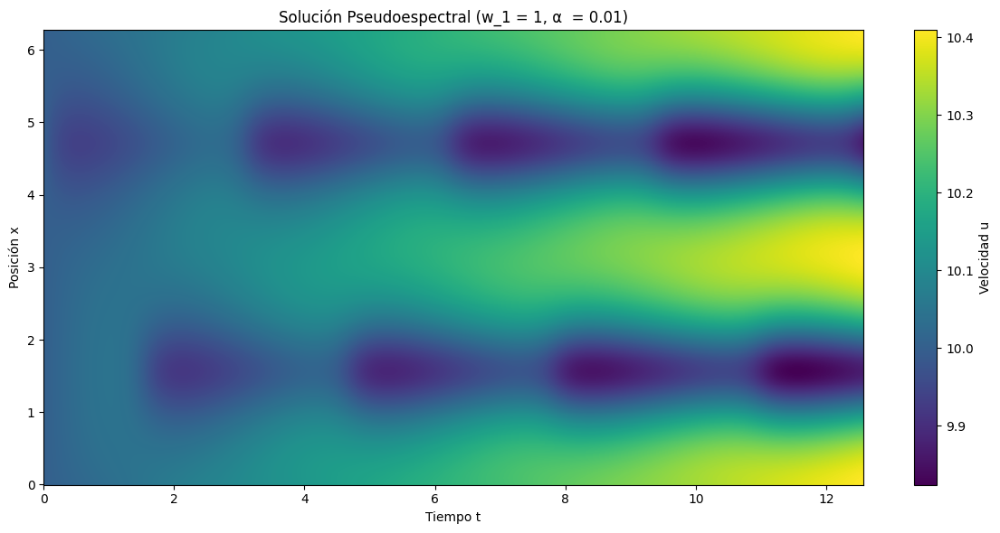

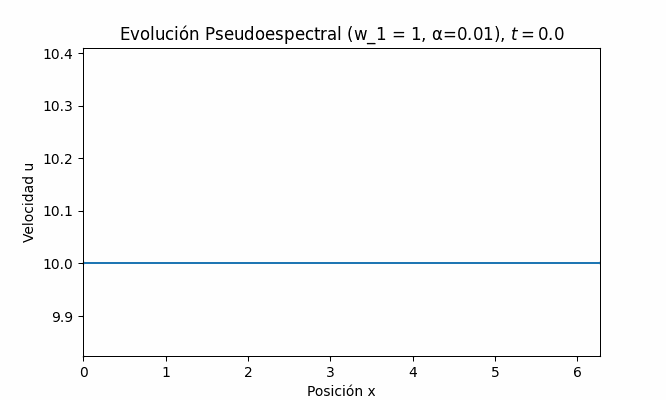

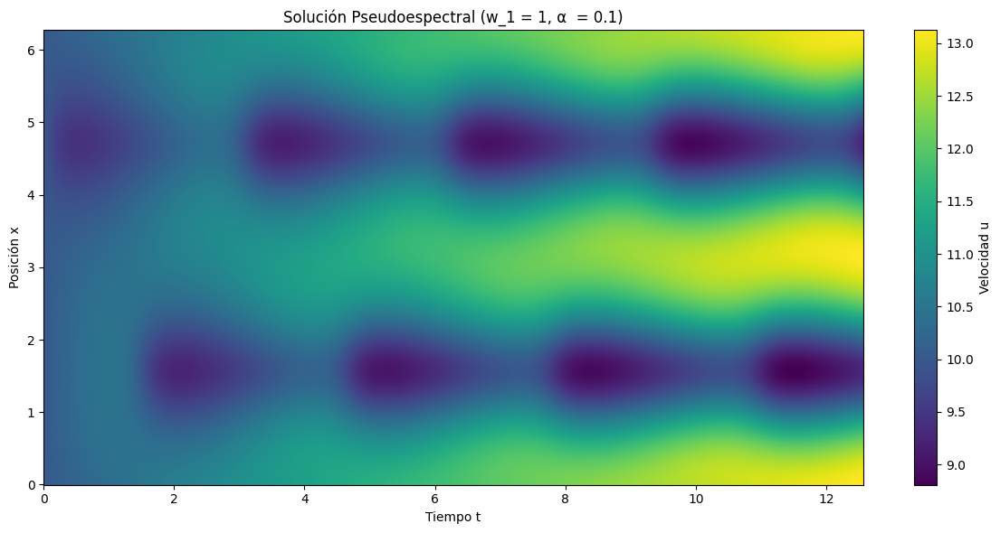

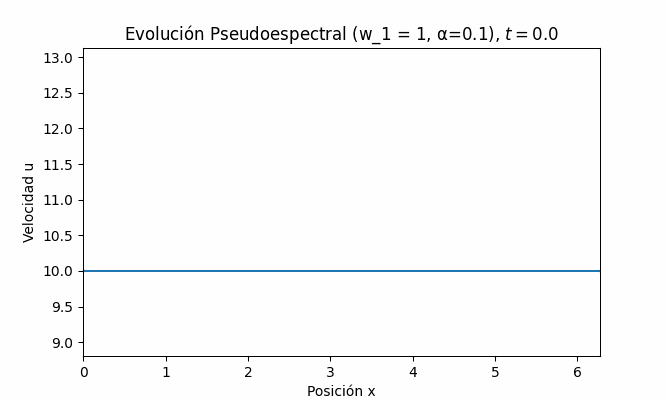

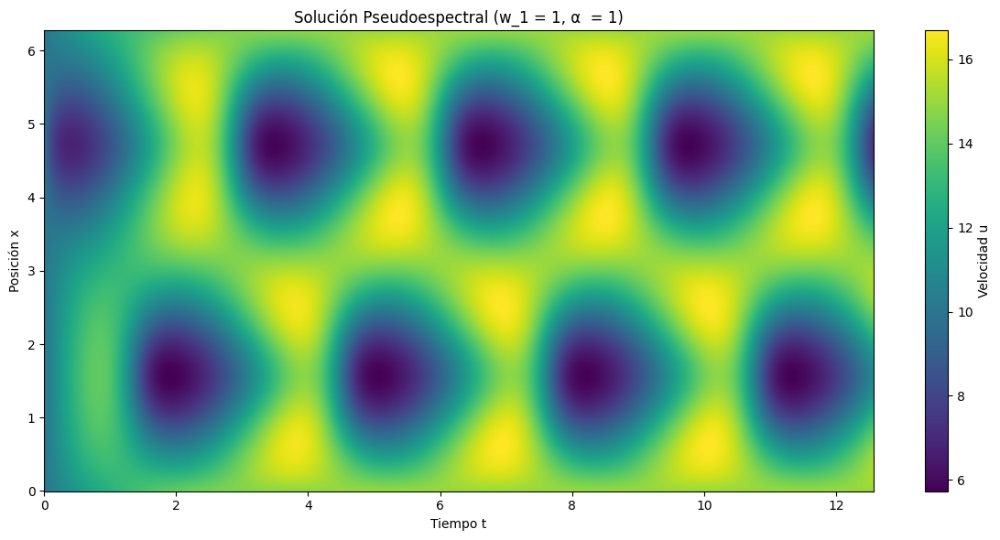

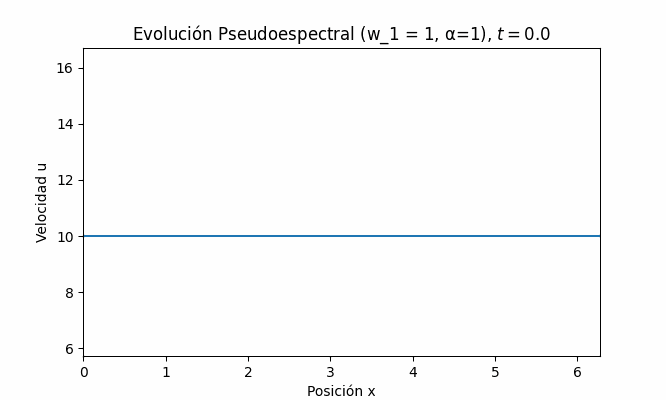

In [ ]:
#@title $\bf f)$  Gráficos para distintos $\alpha $. Pseudoespectral
print("Visualizando soluciones del método pseudoespectral:")
for alpha in alphas:
    solution = sol_out_f[alpha]

    # 1. Heatmap
    x = np.linspace(0, 2*np.pi, nx, endpoint=False)
    t = np.arange(step) * dt
    X, T = np.meshgrid(x, t)

    plt.figure(figsize=(12, 6))
    plt.pcolormesh(T, X, solution.T, cmap='viridis', shading='auto')
    plt.colorbar(label='Velocidad u')
    plt.title(f'Solución Pseudoespectral (w_1 = 1, α  = {alpha})')
    plt.xlabel('Tiempo t')
    plt.ylabel('Posición x')
    plt.tight_layout()
    plt.show()

    # 2. Animación
    animacion(size=(20/3, 4),matriz=solution.T,titulo=f'Evolución Pseudoespectral (w_1 = 1, α={alpha})',ejex='Posición x',ejey='Velocidad u',x=x,dt=dt,tf=step*dt,duracion=6)




Visualizando soluciones del método POD:


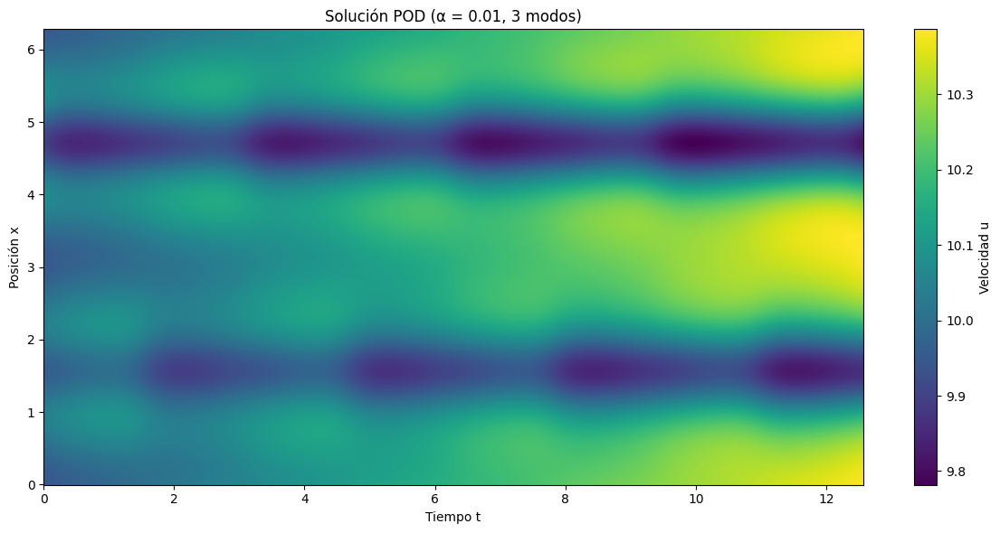

In [ ]:
#@title $\bf f)$ Gráficos para distintos $\alpha $. POD
print("\nVisualizando soluciones del método POD:")
for alpha in alphas:
    # Reconstruir la solución espacial usando los modos POD
    pod_solution = np.zeros((nx, step))
    for i in range(n_modos):
        pod_solution += U_n[:, i].reshape(-1, 1) * sol_pod_f[alpha][:, i].reshape(1, -1)

    # 1. Mapa de calor
    plt.figure(figsize=(12, 6))
    plt.pcolormesh(T, X, pod_solution.T, cmap='viridis', shading='auto')
    plt.colorbar(label='Velocidad u')
    plt.title(f'Solución POD (α = {alpha}, {n_modos} modos)')
    plt.xlabel('Tiempo t')
    plt.ylabel('Posición x')
    plt.tight_layout()
    plt.show()

    # 2. Animación
    animacion(size=(20/3, 4),matriz=pod_solution.T,titulo=f'Evolución POD (α={alpha}, {n_modos} modos)',ejex='Posición x',ejey='Velocidad u',x=x,dt=dt,tf=step*dt,duracion=6)

Visualizando soluciones del método pseudoespectral:


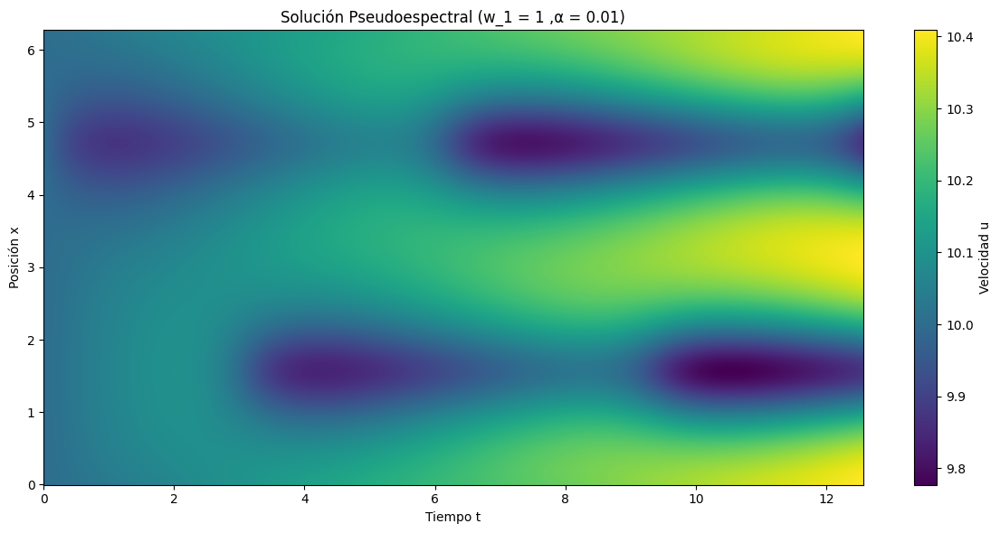

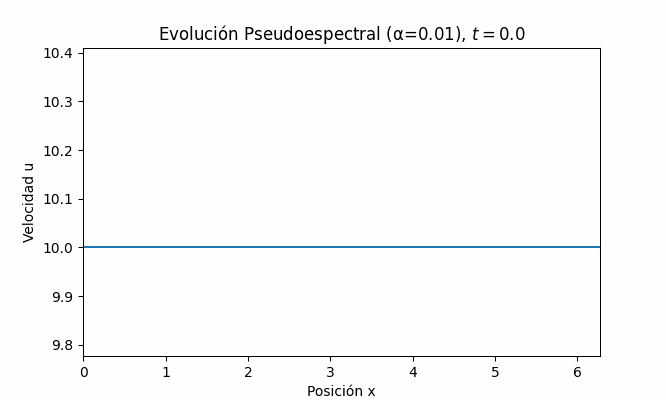

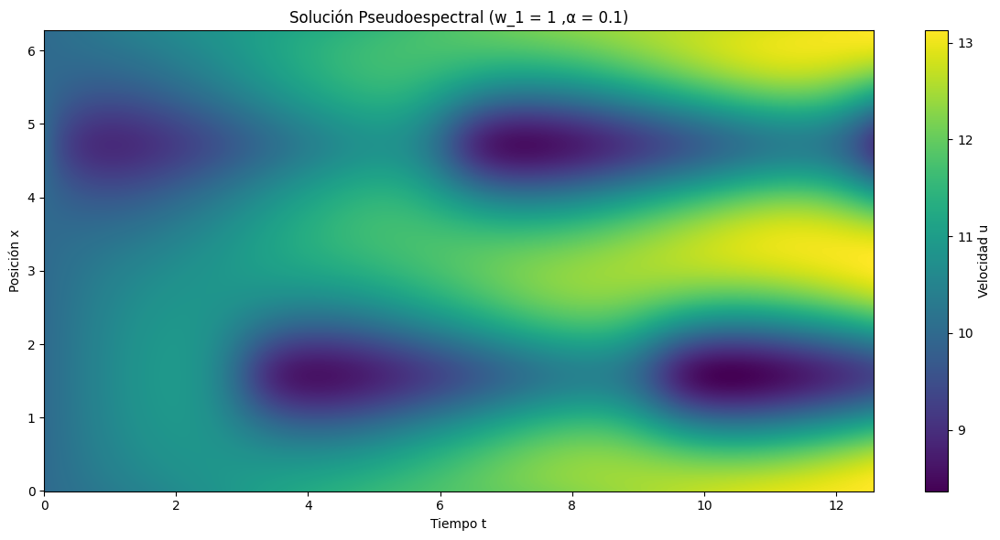

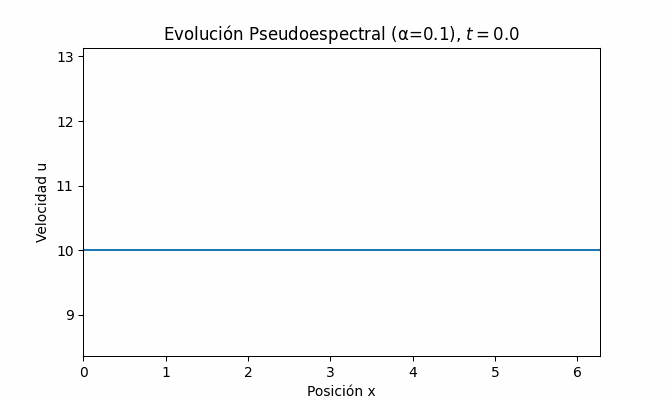

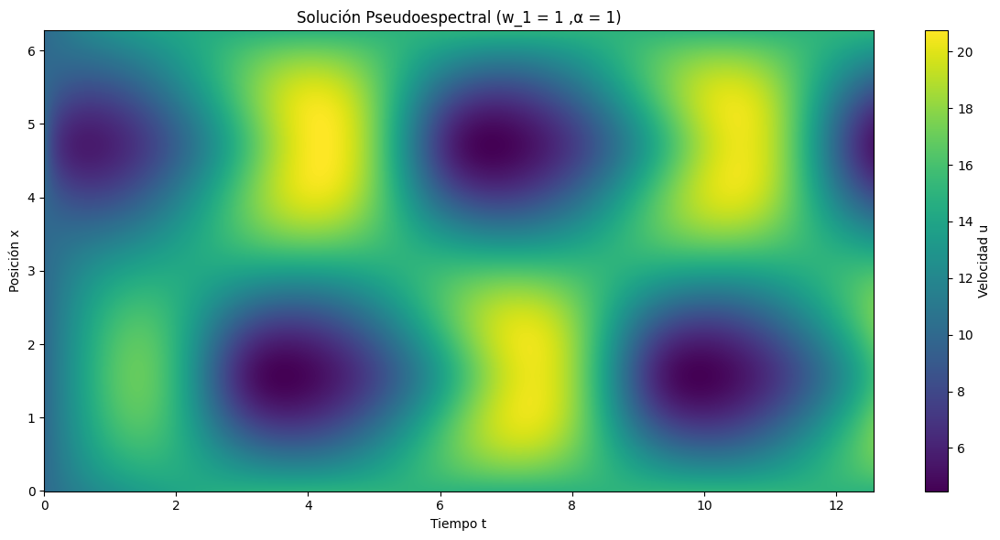

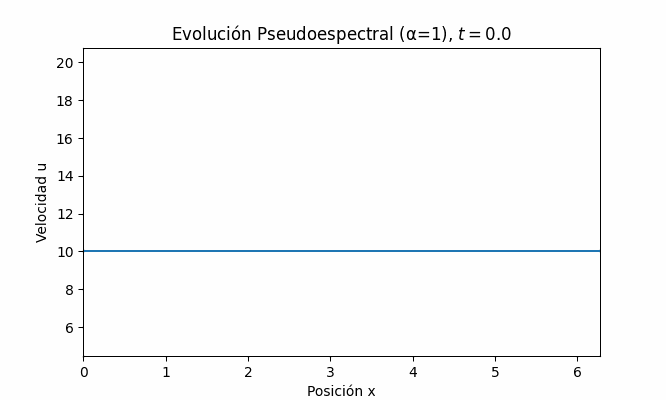

In [ ]:
#@title $\bf g)$ Gráficos para distintos $\alpha $ y $w_1=1$. Pseudoespectral
print("Visualizando soluciones del método pseudoespectral:")
for alpha in alphas:
    solution = sol_out_g[alpha]

    # 1. Heatmap
    x = np.linspace(0, 2*np.pi, nx, endpoint=False)
    t = np.arange(step) * dt
    X, T = np.meshgrid(x, t)

    plt.figure(figsize=(12, 6))
    plt.pcolormesh(T, X, solution.T, cmap='viridis', shading='auto')
    plt.colorbar(label='Velocidad u')
    plt.title(f'Solución Pseudoespectral (w_1 = 1, α  = {alpha})')
    plt.xlabel('Tiempo t')
    plt.ylabel('Posición x')
    plt.tight_layout()
    plt.show()

    # 2. Animación
    animacion(size=(20/3, 4),matriz=solution.T,titulo=f'Evolución Pseudoespectral (w_1 = 1, α={alpha})',ejex='Posición x',ejey='Velocidad u',x=x,dt=dt,tf=step*dt,duracion=6)




Visualizando soluciones del método POD:


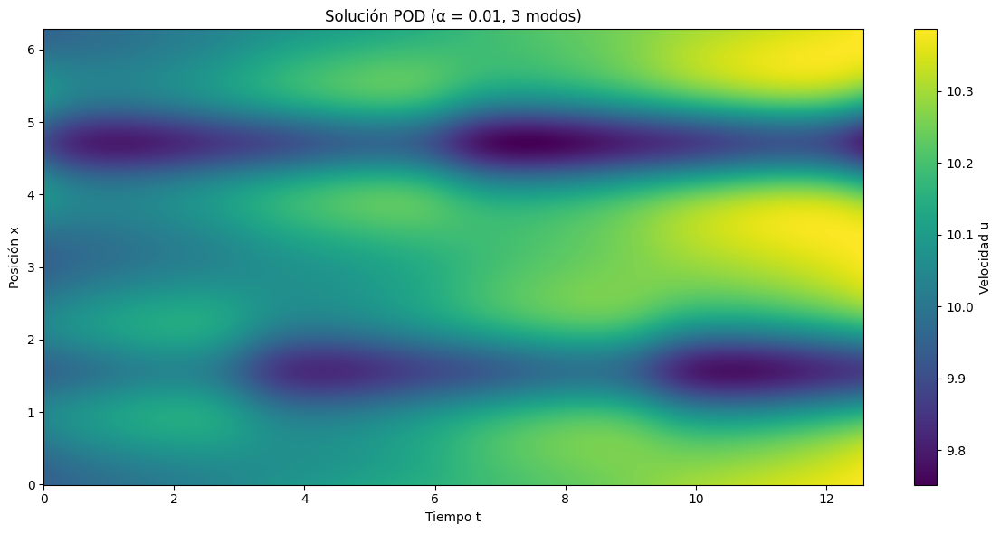

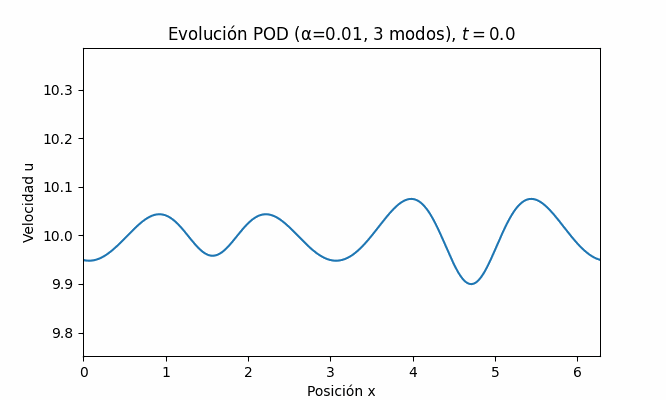

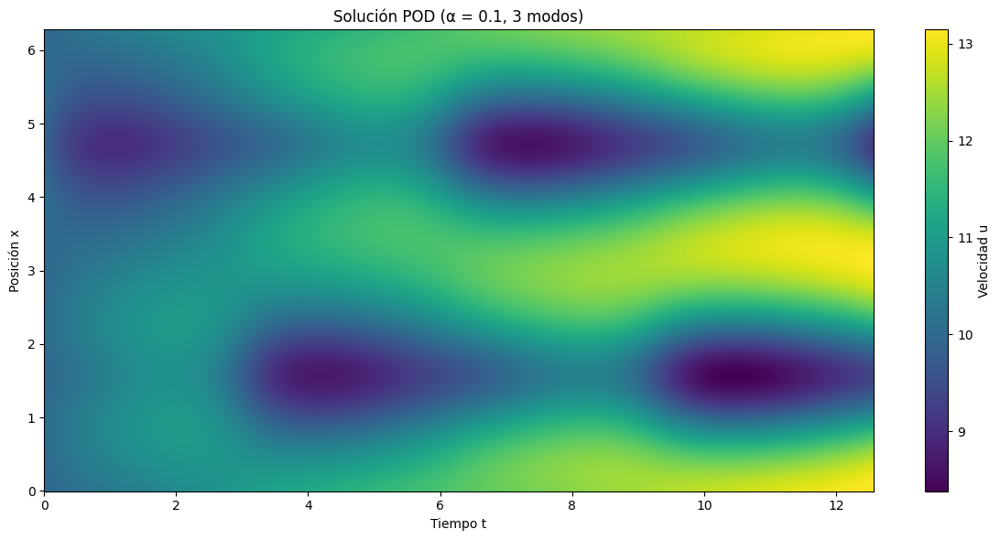

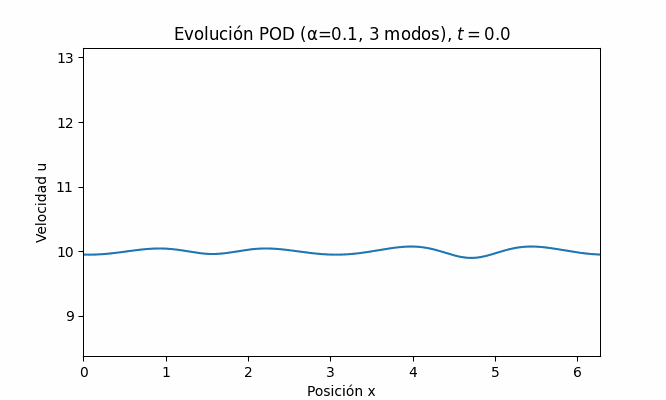

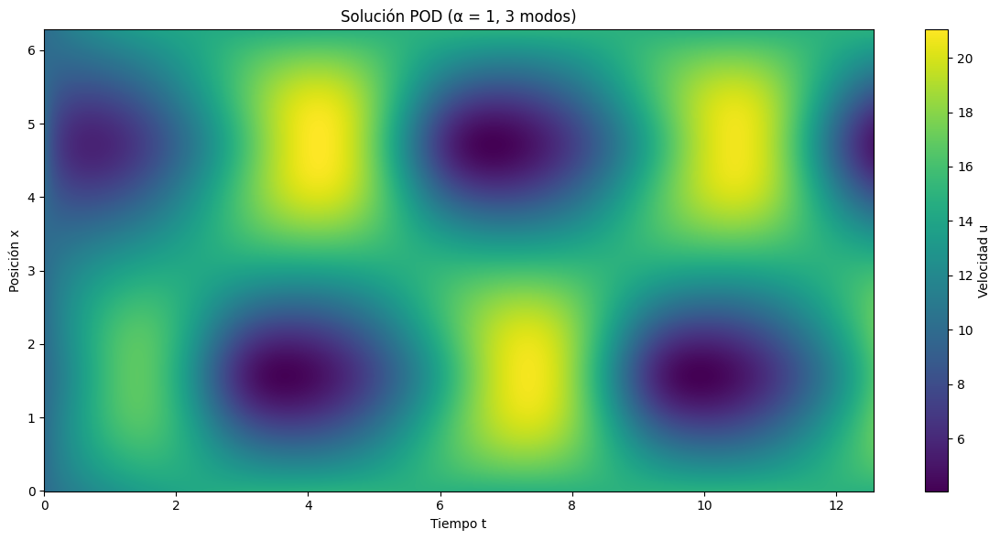

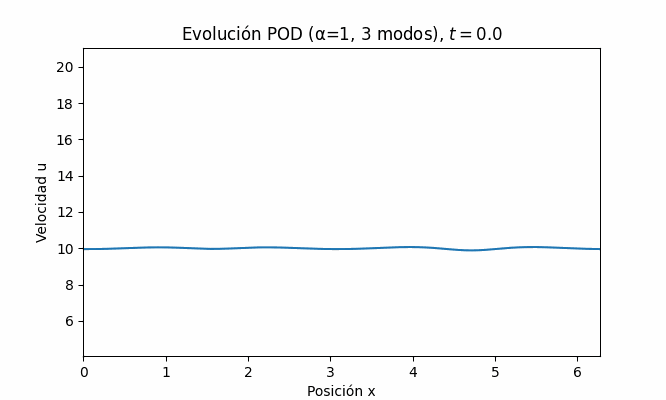

In [ ]:
#@title $\bf g)$ Gráficos para distintos $\alpha $ y $w_1=1$. POD
print("\nVisualizando soluciones del método POD:")
for alpha in alphas:
    # Reconstruir la solución espacial usando los modos POD
    pod_solution = np.zeros((nx, step))
    for i in range(n_modos):
        pod_solution += U_n[:, i].reshape(-1, 1) * sol_pod_g[alpha][:, i].reshape(1, -1)

    # 1. Heatmap
    plt.figure(figsize=(12, 6))
    plt.pcolormesh(T, X, pod_solution.T, cmap='viridis', shading='auto')
    plt.colorbar(label='Velocidad u')
    plt.title(f'Solución POD (α = {alpha}, {n_modos} modos)')
    plt.xlabel('Tiempo t')
    plt.ylabel('Posición x')
    plt.tight_layout()
    plt.show()

    # 2. Animación
    animacion(
        size=(20/3, 4),
        matriz=pod_solution.T,
        titulo=f'Evolución POD (α={alpha}, {n_modos} modos)',
        ejex='Posición x',
        ejey='Velocidad u',
        x=x,
        dt=dt,
        tf=step*dt,
        duracion=6
    )

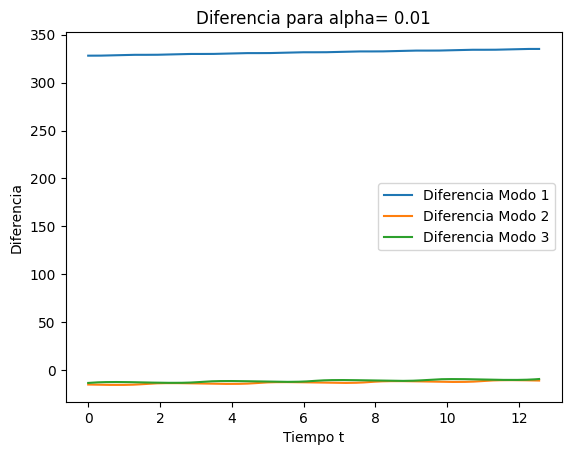

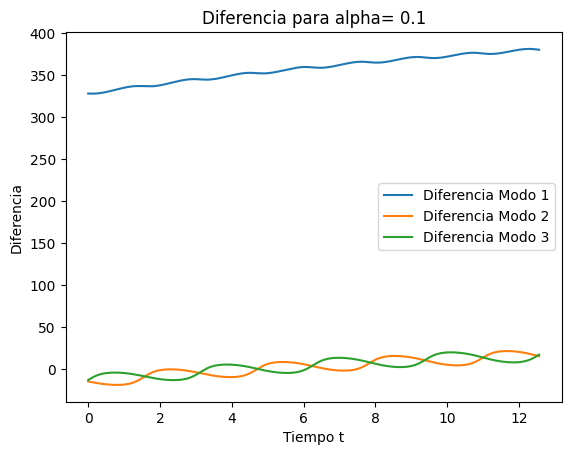

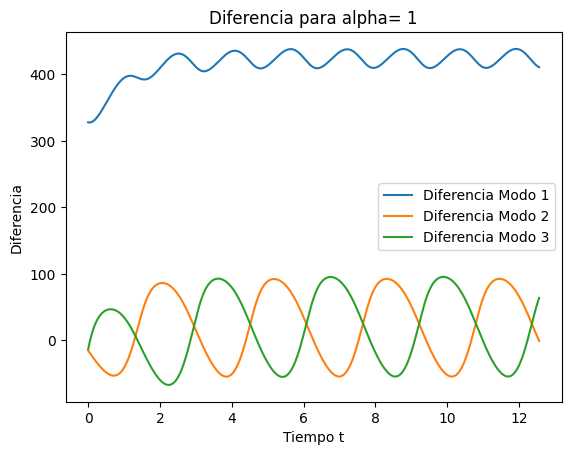

In [ ]:
#@title $\bf f)$ Diferencias para distintos $\alpha $
dif_f=graficar_diferencias(sol_out_f, sol_pod_f, alphas, n_modos, t)

Al variar $\alpha$ estamos cambiando la contribución del término no lineal. Las diferencias se vuelven mayores a medida que nos alejamos del valor original ($\alpha=0.2$), y la no linealidad se vuelve mas presente. Podemos concluir que en los primeros dos casos es válido utilizar los modos obtenidos anteriormente, pero no es así para $\alpha=1$.

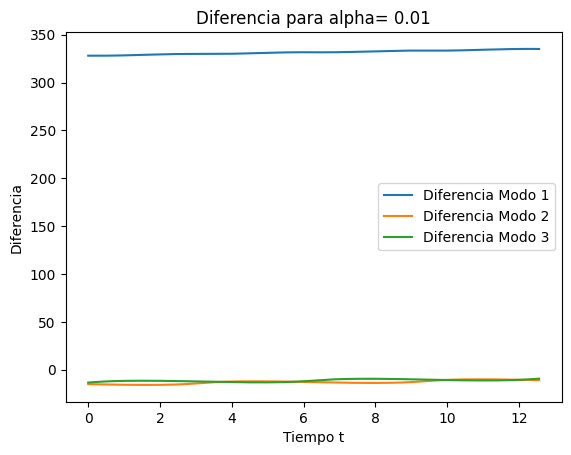

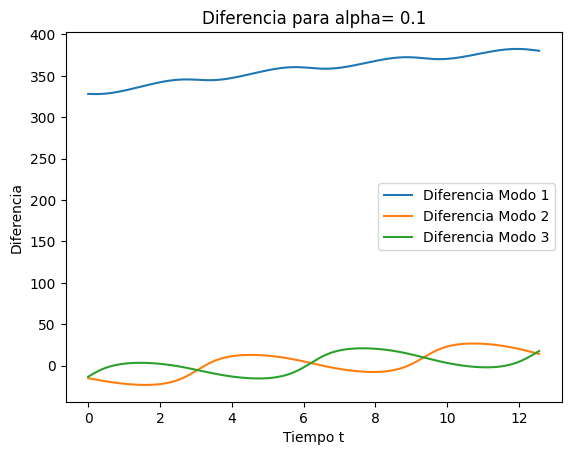

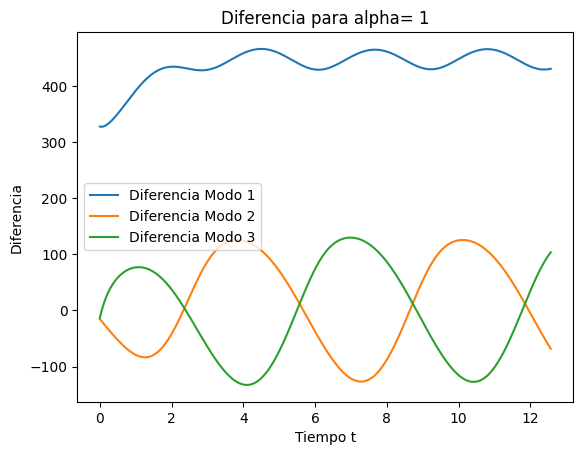

In [ ]:
#@title $\bf g)$ Diferencias con $w_1 =1$ para distintos $\alpha $
dif_g=graficar_diferencias(sol_out_g, sol_pod_g, alphas, n_modos, t)

La diferencia se acentúa por el cambio ahora tambien en el valor de $w_1$. Estamos incluyendo una discrepancia que cambia el comportamiento temporal, por lo que no esperamos que los modos anteriores sigan describiendo correctamente el comportamiento.

$ \mathbf{h)}$ Realizamos la evolución de los coeficientes a partir de la base de Fourier utilizando los 3 primeros modos. Se tomará la solución de la forma

$$ N = \sum_{j=0}^{n} a_j(t) \, \varphi_j(x) $$

donde $ \varphi_j(x) \in B.o.n = \left\{\frac{1}{\sqrt{N_x}} \, , \sqrt{\frac{2}{{N_x}}} \sin{x}, \,  \sqrt{\frac{2}{{N_x}}} \cos{x} \right\} $. Entonces:

donde:

$$ a_0(t) = \frac{1}{L} \int_0^L \frac{1}{\sqrt{N_x}} N(x,t) \, dx $$

$$ a_1(t) = \frac{1}{L} \int_0^L \sqrt{\frac{2}{{N_x}}} N(x,t) \cos{x} \, dx $$

$$ a_2(t) = \frac{1}{L} \int_0^L \sqrt{\frac{2}{{N_x}}} N(x,t) \sin{x} \, dx $$

Por lo que la condicion inicial proyectada en base de fourier se expresa en el discreto como:

$$ a_j(0) = \sum_{j=1}^{Nx} N(x_j,0) \varphi_j(x_j) $$

Así, utilizando el integrador del ítem $ \mathbf{e)} $, podemos obtener la siguiente solución.



In [ ]:
#@title $\bf h)$  Definiendo los $\varphi$ descritos arriba y
n_modos = 3
nx = 1024

phi_prueba = np.zeros((n_modos, nx))
L = 2 * np.pi
# Constante, Coseno, y Seno (normalizados)
x = np.linspace(0,2*np.pi,nx,endpoint=False)

phi_prueba[0] = (1/np.sqrt(nx)) * np.ones(nx)  # Constante
phi_prueba[1] =  (1/np.sqrt(512)) * np.cos( x)  # Coseno
phi_prueba[2] = (1/np.sqrt(512)) * np.sin( x )  # Seno

In [ ]:
#@title Chequeando ortonormalidad de los $\varphi_{i,j}$
def producto_interno(phi_i, phi_j):
    return np.sum(phi_i * phi_j)

producto_matriz = np.zeros((n_modos, n_modos))

for i in range(n_modos):
    for j in range(n_modos):
        producto_matriz[i, j] = producto_interno(phi_prueba[i], phi_prueba[j])

print("Matriz de productos internos:")
print(producto_matriz)

Matriz de productos internos:
[[1.00000000e+00 0.00000000e+00 5.55111512e-17]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [5.55111512e-17 0.00000000e+00 1.00000000e+00]]


In [ ]:
#@title Evolucion

# Inicialización de variables
step = int(4000 * np.pi)
a_j_solucion = np.zeros((step, n_modos))

# Función C (depende del espacio y el tiempo)
def C(x, t, c0, w1, w2):
    return c0 * (1 + 0.8 * np.cos(w1 * t) * np.sin(w2 * x))

# Matriz de C
Cmatriz = np.zeros((step, nx))
for i in range(step):
    Cmatriz[i] = C(x, t[i], c0, w1, w2)

# Valor inicial de a_j
a_j_inicial = np.zeros(n_modos)
U_x_0 = 10 * np.ones(nx)

for i in range(n_modos):
    a_j_inicial[i] = np.sum(U_x_0 * phi_prueba[i])

for i in tqdm(range(step)):
    a_j_solucion[i] = integrador_rk(a_j_inicial, dt, alpha, nu, Cmatriz[i], phi_prueba, dx)
    a_j_inicial = a_j_solucion[i]

100%|██████████| 12566/12566 [00:24<00:00, 506.56it/s]


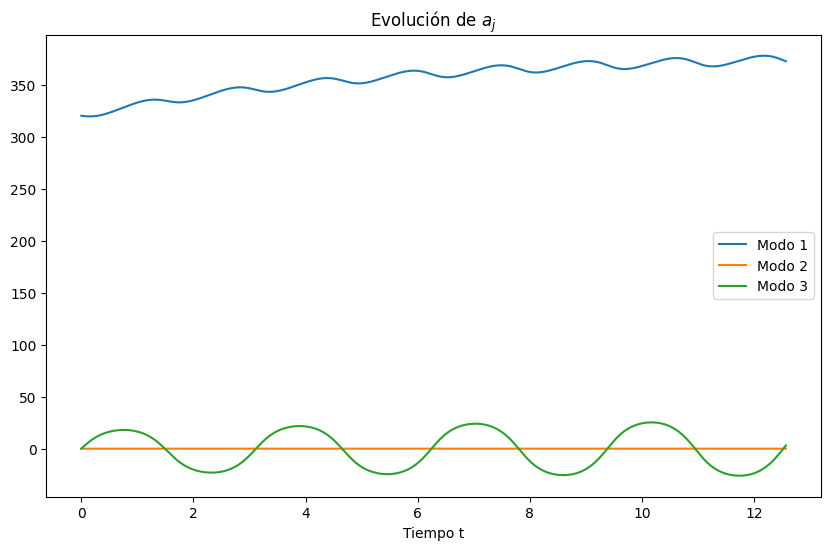

In [ ]:
#@title Evolucion de los modos temporales con la $B.o.n$ propuesta
fig, axes = plt.subplots(1, 1, figsize=(10, 6))

axes.plot(t, a_j_solucion[:, 0], label='Modo 1')
axes.plot(t, a_j_solucion[:, 1], label='Modo 2')
axes.plot(t, a_j_solucion[:, 2], label='Modo 3')
axes.set_title(r'Evolución de $a_j$')
axes.set_xlabel('Tiempo t')
axes.legend()

Se observa como el termino constante realiza el aumento medio de la poblacion, el termino en fase con los recurso (el $sin(x)$) tiene todo el aporte en la oscilacion de la poblacion, mientras que el que se encuentra en contrafase cuenta con nulo aporte.

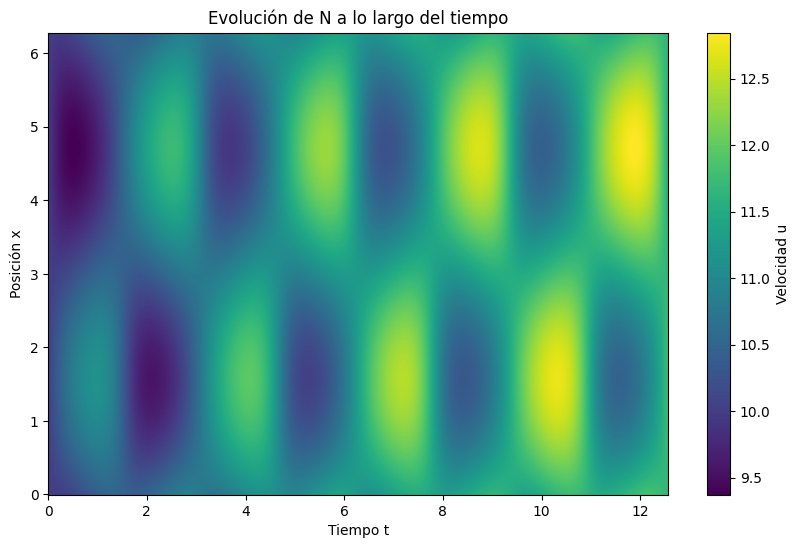

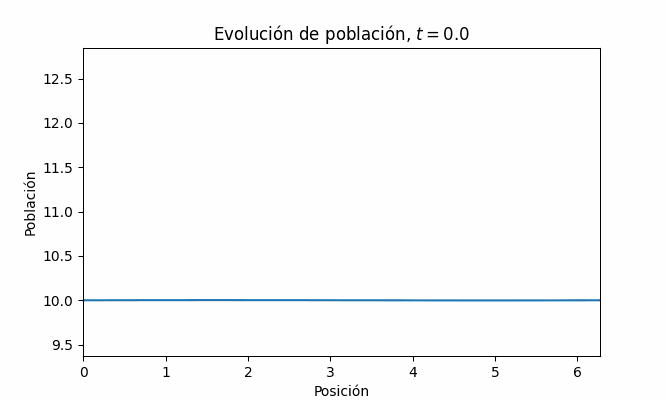

In [ ]:
#@title Grafico de $N$
U_prueba3 = np.zeros((step, nx))
tf = t[-1]
tf

for i in range(step):
    for j in range(n_modos):
        U_prueba3[i] += a_j_solucion[i, j] * phi_prueba[j]


X,T = np.meshgrid(x,t)

plt.figure(figsize=(10, 6))
plt.pcolormesh(T, X, U_prueba3, cmap='viridis')
plt.colorbar(label='Velocidad u')
plt.title('Evolución de N a lo largo del tiempo')
plt.ylabel('Posición x')
plt.xlabel('Tiempo t')
plt.show()

animacion((20/3,4),U_prueba3,'Evolución de población','Posición','Población',x,dt,tf,6)

La reconstruccion no es la mas optima, mas se ve como se preserva de forma cualitativa la dinamica en su forma mas basica, un incremento y una oscilacion.